In [1]:
import torch
import torch.nn as nn
from torchvision.models import AlexNet
from torchvision import transforms
from PIL import Image

import matplotlib.pyplot as plt
import os
from torchsummary import summary

In [4]:
from torchvision.models import AlexNet_Weights

# PRETRAINED ALEXNET MODEL

In [21]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'alexnet',weights = AlexNet_Weights.IMAGENET1K_V1)
model.eval()

Using cache found in C:\Users\Lenovo/.cache\torch\hub\pytorch_vision_v0.10.0


AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [8]:
weights = AlexNet_Weights.IMAGENET1K_V1
weights = AlexNet_Weights.verify(weights)

In [14]:
from torchvision.io import read_image

# PREDICT AN IMAGE

In [50]:
# Step 1: Initialize model with the best available weights


img = read_image("cat.jpg")
# Step 2: Initialize the inference transforms
preprocess = weights.transforms()

# Step 3: Apply inference preprocessing transforms
batch = preprocess(img).unsqueeze(0)

# Step 4: Use the model and print the predicted category
prediction = model(batch).squeeze(0).softmax(0)

class_id = prediction.argmax().item()
score = prediction[class_id].item()
print(class_id)
category_name = weights.meta["categories"][class_id]
print(f"{category_name}: {100 * score:.1f}%")

285
Egyptian cat: 44.4%


C:\Users\Lenovo\anaconda3\lib\site-packages\torchvision\transforms\functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


In [45]:
prediction = model(batch).squeeze(0).softmax(0)
class_count  = 1000
for classid in range(class_count):
    # Step 4: Use the model and print the predicted category
    score = prediction[classid].item()
    category_name = weights.meta["categories"][classid]
    print(f"{category_name}: {100 * score:.6f}%")
    

    
    

tench: 0.000000%
goldfish: 0.000004%
great white shark: 0.000000%
tiger shark: 0.000000%
hammerhead: 0.000000%
electric ray: 0.000020%
stingray: 0.000000%
cock: 0.000010%
hen: 0.000203%
ostrich: 0.000000%
brambling: 0.000107%
goldfinch: 0.000229%
house finch: 0.000004%
junco: 0.000001%
indigo bunting: 0.000008%
robin: 0.000000%
bulbul: 0.000016%
jay: 0.000641%
magpie: 0.000002%
chickadee: 0.000000%
water ouzel: 0.000001%
kite: 0.000012%
bald eagle: 0.000000%
vulture: 0.000002%
great grey owl: 0.000000%
European fire salamander: 0.000000%
common newt: 0.000013%
eft: 0.000000%
spotted salamander: 0.000000%
axolotl: 0.000000%
bullfrog: 0.000002%
tree frog: 0.000000%
tailed frog: 0.000000%
loggerhead: 0.000000%
leatherback turtle: 0.000002%
mud turtle: 0.000000%
terrapin: 0.000015%
box turtle: 0.000001%
banded gecko: 0.000001%
common iguana: 0.000000%
American chameleon: 0.000000%
whiptail: 0.000000%
agama: 0.000000%
frilled lizard: 0.000001%
alligator lizard: 0.000000%
Gila monster: 0.000

# VISUALIZE THE FEATURE MAPS

In [25]:
# Define a function to hook into the chosen layer and extract feature maps
activation = {}

def hook_fn(module, input, output):
    activation['value'] = output

In [28]:
# Create a folder to save feature maps
output_folder = 'feature_maps_alexnet_5'
os.makedirs(output_folder, exist_ok=True)

In [29]:
# Create a folder to save filter visualizations
output_folder_filter= 'filter_visualizations_5'
os.makedirs(output_folder_filter, exist_ok=True)

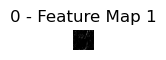

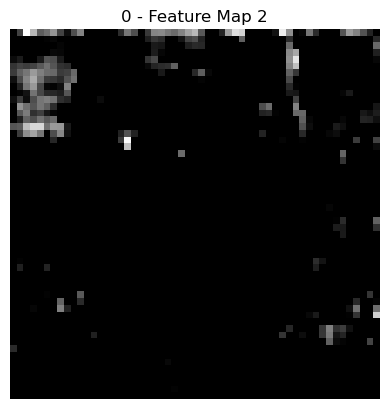

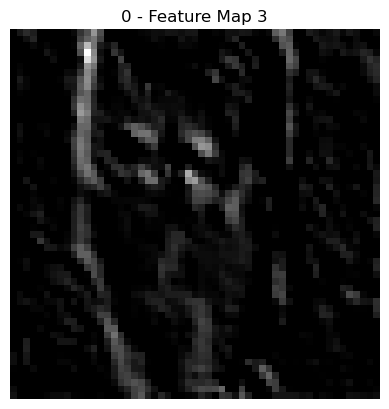

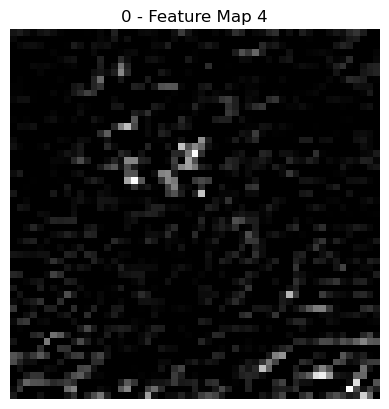

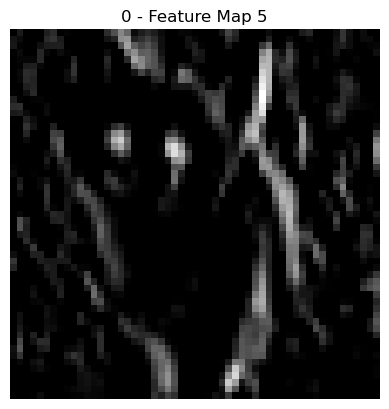

...

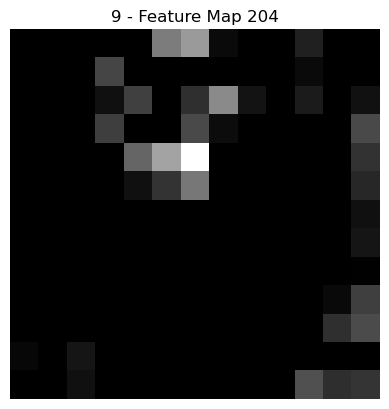

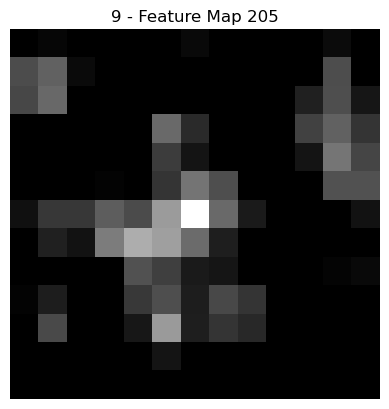

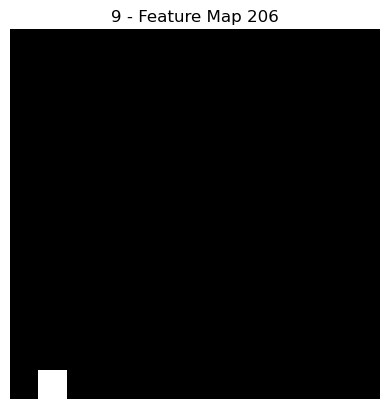

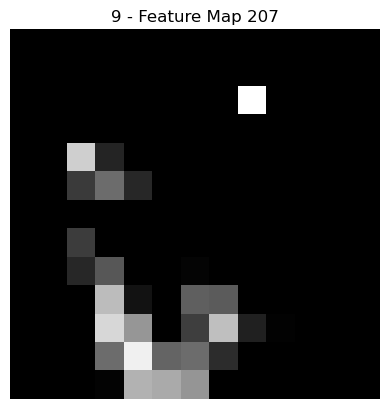

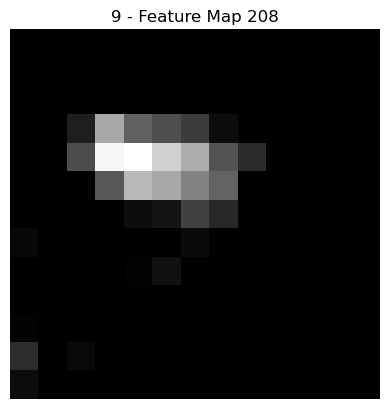

In [31]:
# Visualize feature maps for each layer
plt.figure(figsize=(20, 20))
for layer_name, layer in model.features._modules.items():
    hook = layer.register_forward_hook(hook_fn)
    
    with torch.no_grad():
        output = model(batch)
    feature_maps = activation['value'][0].detach()
    num_feature_maps = feature_maps.size(0)
    
    # Display feature maps in a grid for the current layer
    plt.subplot(num_feature_maps, 1, 1)
    for i in range(num_feature_maps):
        feature_map_image = feature_maps[i].cpu().numpy()
        image_path = os.path.join(output_folder, f'{layer_name}_feature_map_{i + 1}.png')
        plt.imsave(image_path, feature_map_image, cmap='gray')
        
        plt.imshow(feature_maps[i], cmap='gray')
        plt.title(f'{layer_name} - Feature Map {i + 1}')
        plt.axis('off')
        plt.show()
    
    hook.remove()

# FILTER VISUALIZATION

In [32]:
# Loop through each layer to visualize and save filters
for layer_name, layer in model.features._modules.items():
    if isinstance(layer, nn.Conv2d):
        filters = layer.weight.data.cpu().numpy()
        
        # Visualize and save each filter
        for i in range(filters.shape[0]):
            filter_image = filters[i, 0].squeeze() 
            # Save each filter as an image
            image_path = os.path.join(output_folder_filter, f'{layer_name}_filter_{i + 1}.png')
            plt.imsave(image_path, filter_image, cmap='gray')
          #  plt.savefig(image_path)
            
            plt.imshow(filter_image, cmap='gray')
            plt.title(f'{layer_name} - Filter {i + 1}')
            plt.axis('off')
            plt.show()
            
           

# VISUALIZE OUTPUT LAYER

In [51]:
# İlk tam bağlantılı katmandan ağırlıkları çıkar
linear_layer_weights = model.classifier[6].weight.data

# Ağırlıkları görselleştir


num_neurons = linear_layer_weights.size(0)
print(num_neurons)

num_rows = (num_neurons // 10) + 1  # 8 sütunlu bir grid
print(num_rows)
num_cols = 10


# Show top categories per image
#top5_prob, top5_catid = torch.topk(probabilities, 1000)
#for i in range(top5_prob.size(0)):
  #  print(categories[top5_catid[i]], top5_prob[i].item())


plt.figure(figsize=(120, 56))
for i in range(num_neurons):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.imshow(linear_layer_weights[i].cpu().numpy().reshape(1, -1),cmap='gray', aspect='auto')
    score= prediction[i].item()
    plt.title(f'{i},{100 * score:.6f}%')
    plt.axis('off')

plt.show()

1000
101
